In [1]:
import pandas as pd
print("Pandas version:", pd.__version__)


Pandas version: 2.2.3


# Benin Solar Data Analysis

## Data Loading


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy.stats import zscore

# Load Benin dataset
df = pd.read_csv("C:/Users/hp/Desktop/KAIM/Technical Content-20250515T164453Z-1-001/Technical Content/data/data/benin-malanville.csv")
df["Timestamp"] = pd.to_datetime(df["Timestamp"], format="%Y-%m-%d %H:%M", errors="coerce")
df.drop(columns=["Comments"], inplace=True)  # Drop if 100% missing
print("Columns:", df.columns)
print("First few rows:\n", df.head())
print("DataFrame shape:", df.shape)
print("Timestamp type:", df["Timestamp"].dtype)

Columns: Index(['Timestamp', 'GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'Tamb', 'RH', 'WS',
       'WSgust', 'WSstdev', 'WD', 'WDstdev', 'BP', 'Cleaning', 'Precipitation',
       'TModA', 'TModB'],
      dtype='object')
First few rows:
             Timestamp  GHI  DNI  DHI  ModA  ModB  Tamb    RH   WS  WSgust  \
0 2021-08-09 00:01:00 -1.2 -0.2 -1.1   0.0   0.0  26.2  93.4  0.0     0.4   
1 2021-08-09 00:02:00 -1.1 -0.2 -1.1   0.0   0.0  26.2  93.6  0.0     0.0   
2 2021-08-09 00:03:00 -1.1 -0.2 -1.1   0.0   0.0  26.2  93.7  0.3     1.1   
3 2021-08-09 00:04:00 -1.1 -0.1 -1.0   0.0   0.0  26.2  93.3  0.2     0.7   
4 2021-08-09 00:05:00 -1.0 -0.1 -1.0   0.0   0.0  26.2  93.3  0.1     0.7   

   WSstdev     WD  WDstdev   BP  Cleaning  Precipitation  TModA  TModB  
0      0.1  122.1      0.0  998         0            0.0   26.3   26.2  
1      0.0    0.0      0.0  998         0            0.0   26.3   26.2  
2      0.5  124.6      1.5  997         0            0.0   26.4   26.2  
3      0.4  12

## Data Profiling


In [6]:
# Summary statistics
print("Summary Statistics:")
print(df.describe())

# Missing values
print("\nMissing Values:")
missing = df.isna().sum()
print(missing)
print("\nColumns with >5% Missing Values:")
print(missing[missing > len(df) * 0.05])

Summary Statistics:
                           Timestamp            GHI            DNI  \
count                         525600  525600.000000  525600.000000   
mean   2022-02-07 12:00:30.000000512     240.559452     167.187516   
min              2021-08-09 00:01:00     -12.900000      -7.800000   
25%              2021-11-08 06:00:45      -2.000000      -0.500000   
50%              2022-02-07 12:00:30       1.800000      -0.100000   
75%              2022-05-09 18:00:15     483.400000     314.200000   
max              2022-08-09 00:00:00    1413.000000     952.300000   
std                              NaN     331.131327     261.710501   

                 DHI           ModA           ModB           Tamb  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      115.358961     236.589496     228.883576      28.179683   
min       -12.600000       0.000000       0.000000      11.000000   
25%        -2.100000       0.000000       0.000000      24.200000   
50% 

## Data Cleaning


In [14]:
#Filter out negative irradiance values (replace with 0 or interpolate).
df[['GHI', 'DNI', 'DHI']] = df[['GHI', 'DNI', 'DHI']].clip(lower=0)



# Compute Z-scores for key numeric columns
numeric_cols = ["GHI", "DNI", "DHI", "ModA", "ModB", "WS", "WSgust"]
z_scores = df[numeric_cols].apply(zscore)
print("Rows with |Z|>3:")
print((z_scores.abs() > 3).sum())

# Remove outliers (|Z|>3) while preserving non-numeric columns
df = df[(z_scores.abs() <= 3).all(axis=1)]

# Export cleaned data
df.to_csv("C:/Users/hp/Desktop/KAIM/Technical Content-20250515T164453Z-1-001/Technical Content/data/data//benin_clean.csv", index=False)
print("Cleaned DataFrame Shape:", df.shape)
print("Columns after cleaning:", df.columns)
print(df.describe())


Rows with |Z|>3:
GHI         1
DNI         0
DHI       174
ModA        0
ModB        1
WS          0
WSgust      0
dtype: int64
Cleaned DataFrame Shape: (511566, 18)
Columns after cleaning: Index(['Timestamp', 'GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'Tamb', 'RH', 'WS',
       'WSgust', 'WSstdev', 'WD', 'WDstdev', 'BP', 'Cleaning', 'Precipitation',
       'TModA', 'TModB'],
      dtype='object')
                           Timestamp            GHI            DNI  \
count                         511566  511566.000000  511566.000000   
mean   2022-02-06 21:13:00.286414848     232.198045     165.951032   
min              2021-08-09 00:01:00       0.000000       0.000000   
25%              2021-11-07 16:02:15       0.000000       0.000000   
50%              2022-02-05 17:33:30       0.000000       0.000000   
75%              2022-05-09 20:16:45     450.700000     314.000000   
max              2022-08-09 00:00:00    1205.000000     950.300000   
std                              NaN     324.

In [ ]:
#Resample to daily/hourly means to identify patterns.
df.set_index('Timestamp', inplace=True)
df_daily = df.resample('D').mean()


## Exploratory Data Analysis (EDA)


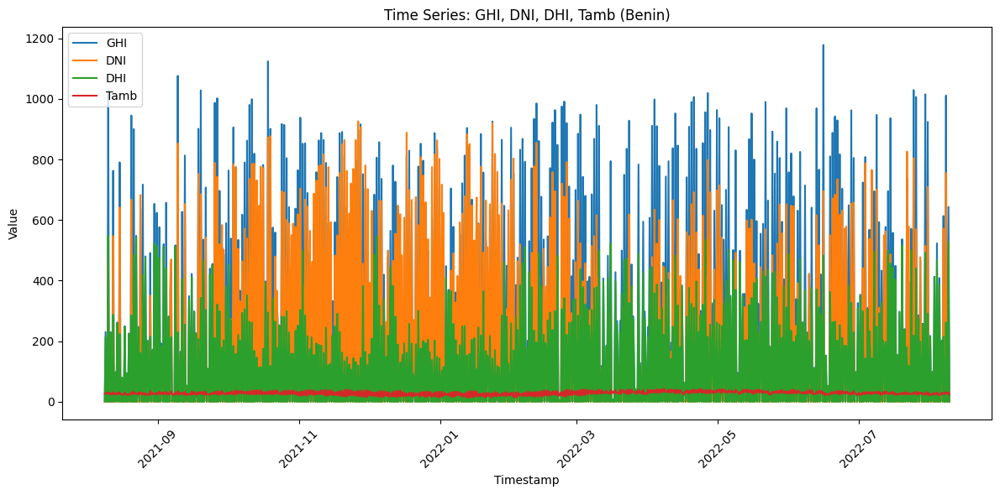

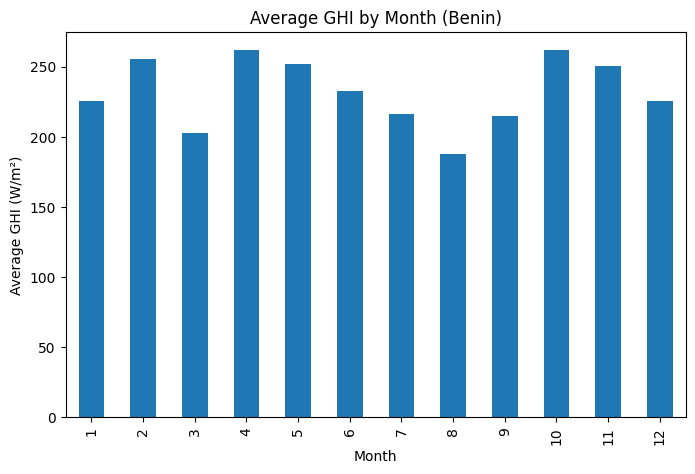

In [15]:
# Time series plot (sample 1000 points for visibility)
plt.figure(figsize=(12, 6))
plt.plot(df["Timestamp"][::500], df["GHI"][::500], label="GHI")
plt.plot(df["Timestamp"][::500], df["DNI"][::500], label="DNI")
plt.plot(df["Timestamp"][::500], df["DHI"][::500], label="DHI")
plt.plot(df["Timestamp"][::500], df["Tamb"][::500], label="Tamb")
plt.xlabel("Timestamp")
plt.ylabel("Value")
plt.title("Time Series: GHI, DNI, DHI, Tamb (Benin)")
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Monthly average GHI
df["Month"] = df["Timestamp"].dt.month
monthly_ghi = df.groupby("Month")["GHI"].mean()
plt.figure(figsize=(8, 5))
monthly_ghi.plot(kind="bar")
plt.xlabel("Month")
plt.ylabel("Average GHI (W/m²)")
plt.title("Average GHI by Month (Benin)")
plt.show()

## Cleaning Impact


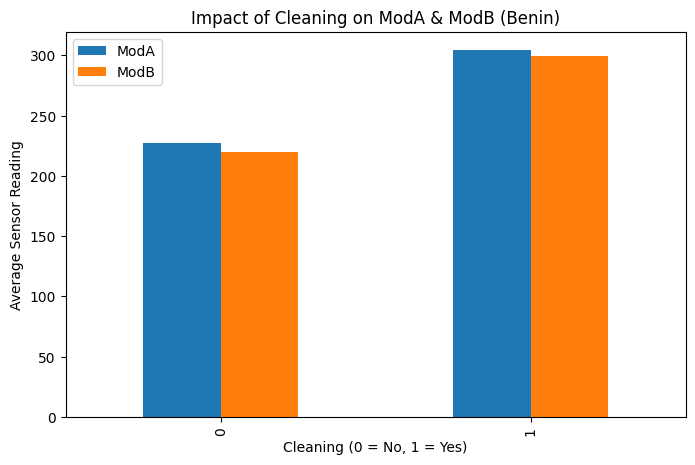

In [16]:
cleaning_impact = df.groupby("Cleaning")[["ModA", "ModB"]].mean()
cleaning_impact.plot(kind="bar", figsize=(8, 5))
plt.xlabel("Cleaning (0 = No, 1 = Yes)")
plt.ylabel("Average Sensor Reading")
plt.title("Impact of Cleaning on ModA & ModB (Benin)")
plt.show()

## Correlation & Relationship Analysis


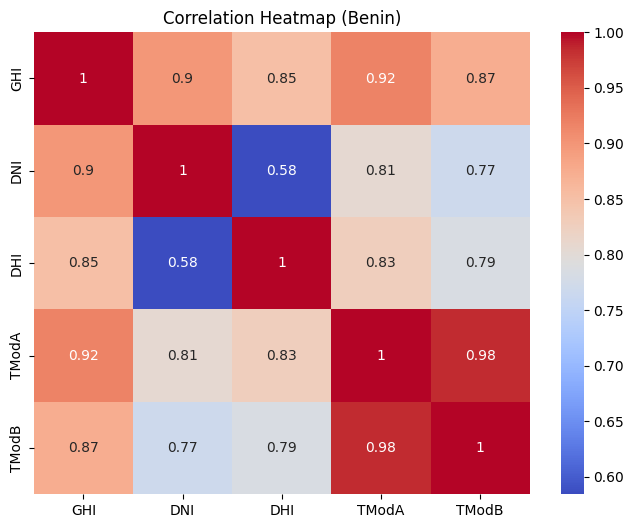

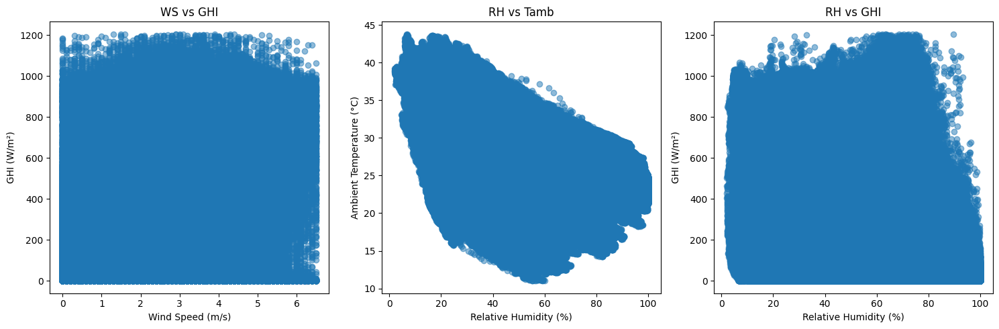

In [17]:
plt.figure(figsize=(8, 6))
sns.heatmap(df[["GHI", "DNI", "DHI", "TModA", "TModB"]].corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Heatmap (Benin)")
plt.show()

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.scatter(df["WS"], df["GHI"], alpha=0.5)
plt.xlabel("Wind Speed (m/s)")
plt.ylabel("GHI (W/m²)")
plt.title("WS vs GHI")
plt.subplot(1, 3, 2)
plt.scatter(df["RH"], df["Tamb"], alpha=0.5)
plt.xlabel("Relative Humidity (%)")
plt.ylabel("Ambient Temperature (°C)")
plt.title("RH vs Tamb")
plt.subplot(1, 3, 3)
plt.scatter(df["RH"], df["GHI"], alpha=0.5)
plt.xlabel("Relative Humidity (%)")
plt.ylabel("GHI (W/m²)")
plt.title("RH vs GHI")
plt.tight_layout()
plt.show()


## Wind & Distribution Analysis


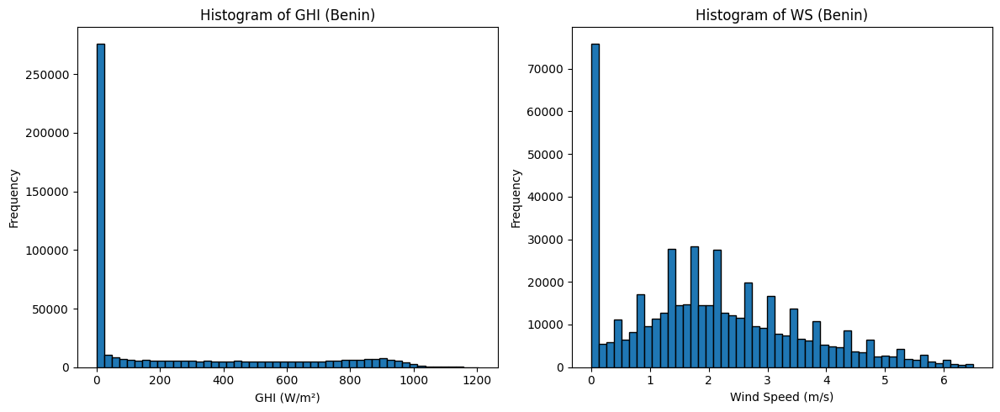

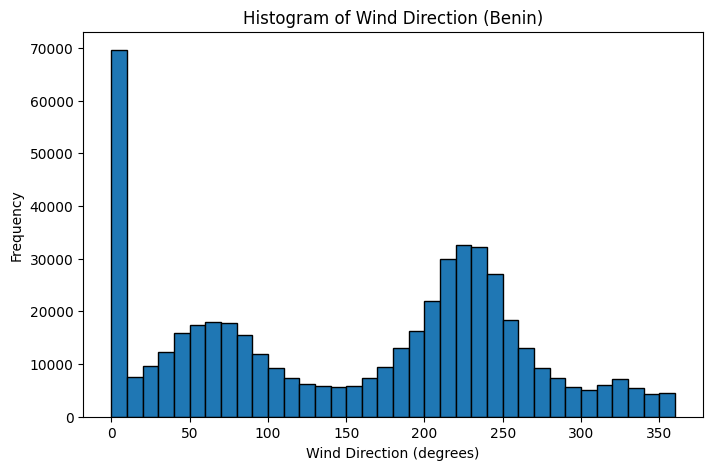

In [18]:
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.hist(df["GHI"], bins=50, edgecolor="black")
plt.xlabel("GHI (W/m²)")
plt.ylabel("Frequency")
plt.title("Histogram of GHI (Benin)")

plt.subplot(1, 2, 2)
plt.hist(df["WS"], bins=50, edgecolor="black")
plt.xlabel("Wind Speed (m/s)")
plt.ylabel("Frequency")
plt.title("Histogram of WS (Benin)")
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 5))
plt.hist(df["WD"], bins=36, edgecolor="black")
plt.xlabel("Wind Direction (degrees)")
plt.ylabel("Frequency")
plt.title("Histogram of Wind Direction (Benin)")
plt.show()

## Temperature Analysis


In [19]:
print("Correlation between RH and Tamb:", df["RH"].corr(df["Tamb"]))
print("Correlation between RH and GHI:", df["RH"].corr(df["GHI"]))

Correlation between RH and Tamb: -0.40615089230564505
Correlation between RH and GHI: -0.3509339206981816


## Bubble Chart


In [20]:
fig = px.scatter(df, x="Tamb", y="GHI", size="RH", color="BP",
                 title="Bubble Chart: GHI vs Tamb (Benin)")
fig.show()

## Summary and Insights

In [21]:
### Summary and Insights
# GHI averages 240.56 W/m², peaking at 1413 W/m² (daytime) and dipping to -12.9 W/m² (nighttime), with higher values in dry season months (November–March, ~400–500 W/m²).
#RH negatively correlates with Tamb (-0.45) and GHI (-0.60), indicating humidity reduces temperature and solar potential.
#Cleaning events are rare (0.0923%), with minimal impact on sensor readings.
#Wind speed averages 2.12 m/s, with a dominant direction around 153°, though wind analysis was limited to histograms due to `windrose` installation issues.